### Libraries

In [ ]:
import os
import numpy as np
from PIL import Image

import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras.models import save_model
from tensorflow.keras.models import load_model
from tensorflow.keras import models
from tensorflow.keras import layers
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import vgg16
from tensorflow.keras.applications import VGG16
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
from keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import ImageDataGenerator
from keras.applications.vgg16 import preprocess_input
from xml.etree import ElementTree as ET
from sklearn.metrics import average_precision_score, accuracy_score, precision_recall_curve, auc
import gc
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
from tensorflow.keras.utils import Sequence
from tqdm import tqdm
import pandas as pd
from IPython.display import Image, display
import seaborn as sns

import os
import numpy as np
from tensorflow import keras
from tensorflow.keras import layers
from PIL import Image
import tensorflow as tf

### Models Directory To save the model

In [ ]:
os.makedirs("/content/models")
print("Folder created successfully.")

Folder created successfully.


### Downloading The Data

In [ ]:
ANNOTATION_DIR ='VOCdevkit/VOC2008/Annotations'
LABELS_DIR     = 'VOCdevkit/VOC2008/ImageSets/Main'
TRAIN_DIR = 'VOCdevkit/VOC2008/ImageSets/Main/train.txt'
VAL_DIR ='VOCdevkit/VOC2008/ImageSets/Main/val.txt'
IMAGES_DIR = 'VOCdevkit/VOC2008/JPEGImages'
OUTPUT_DIR='dataset.csv'

tf.keras.utils.set_random_seed(42)

!wget http://host.robots.ox.ac.uk/pascal/VOC/voc2008/VOCtrainval_14-Jul-2008.tar
!tar -xf VOCtrainval_14-Jul-2008.tar

--2024-04-08 16:24:12--  http://host.robots.ox.ac.uk/pascal/VOC/voc2008/VOCtrainval_14-Jul-2008.tar
Resolving host.robots.ox.ac.uk (host.robots.ox.ac.uk)... 129.67.94.152
Connecting to host.robots.ox.ac.uk (host.robots.ox.ac.uk)|129.67.94.152|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 577034240 (550M) [application/x-tar]
Saving to: ‘VOCtrainval_14-Jul-2008.tar.1’

VOCtrainval_14-Jul- 100%[===================>] 550.30M  16.4MB/s    in 30s     

2024-04-08 16:24:42 (18.5 MB/s) - ‘VOCtrainval_14-Jul-2008.tar.1’ saved [577034240/577034240]



#### Preprocessing the Data and Saving in Dataframe

In [ ]:
def get_unique_labels(labels_dir):
    labels = os.listdir(labels_dir)
    labels = sorted(list(set([label.split('_')[0] for label in labels if len(label.split('_')) > 1])))
    return labels

def read_file_list(file_path):
    with open(file_path, "r") as f:
        files = [line.strip() for line in f.readlines()]
    return files

def extract_labels_from_xml(file_names, annotation_dir):
    targets = []
    for file in tqdm(file_names, desc="Extracting labels"):
        file_path = os.path.join(annotation_dir, file + ".xml")
        labels = [box.find('name').text for box in ET.parse(file_path).getroot().iter('object')]
        targets.append(labels)
    return targets

def create_dataframe(train_files, val_files, train_targets, val_targets):
    df_train = pd.DataFrame({'id': train_files, 'set': 'train', 'target': train_targets})
    df_val = pd.DataFrame({'id': val_files, 'set': 'val', 'target': val_targets})
    df = pd.concat([df_train, df_val], ignore_index=True)
    df['id'] = df['id'] + '.jpg'
    return df

def save_dataframe_to_csv(df, output_dir):
    df.to_csv(output_dir, index=False)

def read_dataframe_from_csv(input_dir):
    df = pd.read_csv(input_dir)
    df['target'] = df['target'].apply(eval)
    return df

In [ ]:
# Read training and validation set files
train_files = read_file_list(TRAIN_DIR)
val_files = read_file_list(VAL_DIR)
print("Training Size: ", len(train_files))
print("Validation Size: ", len(val_files))
print("\n\n\n")

train_targets = extract_labels_from_xml(train_files, ANNOTATION_DIR)
val_targets = extract_labels_from_xml(val_files, ANNOTATION_DIR)

df = create_dataframe(train_files, val_files, train_targets, val_targets) # dataframe (id, train/test set, target)
save_dataframe_to_csv(df, OUTPUT_DIR)
df = read_dataframe_from_csv(OUTPUT_DIR)

print("\n\n\n")
# Display unique labels and DataFrame
labels = get_unique_labels(LABELS_DIR)
print("The labels are", labels)
print("\n\n\n")
df

Training Size:  2111
Validation Size:  2221






Extracting labels: 100%|██████████| 2221/2221 [00:00<00:00, 7368.58it/s]






The labels are ['aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus', 'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike', 'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tvmonitor']






,id,set,target
0,2008_000008.jpg,train,"[horse, person]"
1,2008_000015.jpg,train,"[bottle, bottle]"
2,2008_000019.jpg,train,"[dog, dog, dog]"
3,2008_000023.jpg,train,"[tvmonitor, bottle, person, person, person]"
4,2008_000028.jpg,train,"[car, car]"
...,...,...,...
4327,2008_008755.jpg,val,"[person, person, bicycle]"
4328,2008_008758.jpg,val,"[bicycle, person]"
4329,2008_008765.jpg,val,[aeroplane]
4330,2008_008767.jpg,val,[train]


# VAE

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Function to load images
def load_images(image_paths):
    images = []
    for image_path in image_paths:
        try:
            image = Image.open(image_path)
            image = image.resize((28, 28))  # Resize images to fit VAE input size
            image = np.array(image) / 255.0  # Normalize pixel values
            images.append(image)
        except Exception as e:
            print(f"Error loading image '{image_path}': {e}")
    return np.array(images)

### VAE Architecture

In [ ]:
# Sampling layer
class Sampling(layers.Layer):
    def call(self, inputs):
        mean, log_var = inputs
        batch = tf.shape(mean)[0]
        dim = tf.shape(mean)[1]
        epsilon = tf.random.normal(shape=(batch, dim))
        return mean + tf.exp(0.5 * log_var) * epsilon


def create_training_samples(class_name, image_folder):
    # Read filenames from train.txt
    train_filenames = []
    with open(os.path.join(image_folder, "ImageSets", "Main", f"{class_name}_train.txt"), 'r') as file:
        train_filenames += file.read().splitlines()

#[Errno 2] No such file or directory: '/content/VOCdevkit/ImageSets/Main/aeroplane_train.txt'
#/content/VOCdevkit/VOC2008/ImageSets/Main


    # Combine filenames from all lists and remove duplicates
    all_filenames = list(set(train_filenames))

    print("Filenames from text files:")
    print(all_filenames)

    # Construct image paths and filter out missing files
    image_paths = []
    for filename in all_filenames:
        # Extract the label
        label = filename.strip().split()[1]  # Get the label part of the filename
        if label == '-1':
            continue  # Skip this image if the label is '-1'

        # Remove leading/trailing spaces and the "-1" suffix
        filename = filename.strip().split()[0]  # Split by space and take the first part
        image_path = os.path.join(image_folder, "JPEGImages", filename + '.jpg')  # Append '.jpg' after filename
        if os.path.exists(image_path):
            image_paths.append(image_path)
        else:
            print(f"File not found: {image_path}. Skipping...")
    if not image_paths:
        print(f"No images found for class: {class_name}. Skipping training...")
    else:
        # Load images
        images = load_images(image_paths)
        return images

# Define VAE model architecture
latent_dim = 2

# Encoder
encoder_inputs = keras.Input(shape=(28, 28, 3))
x = layers.Conv2D(256, 3, activation="relu", strides=2, padding="same")(encoder_inputs)
x = layers.Conv2D(512, 3, activation="relu", strides=2, padding="same")(x)
x = layers.Conv2D(1024, 3, activation="relu", strides=2, padding="same")(x)
x = layers.Flatten()(x)
x = layers.Dense(512, activation="relu")(x)
mean = layers.Dense(latent_dim, name="mean")(x)
log_var = layers.Dense(latent_dim, name="log_var")(x)
z = Sampling()([mean, log_var])
encoder = keras.Model(encoder_inputs, [mean, log_var, z], name="encoder")


# Decoder
latent_inputs = keras.Input(shape=(latent_dim,))
x = layers.Dense(7 * 7 * 1024, activation="relu")(latent_inputs)
x = layers.Reshape((7, 7, 1024))(x)
x = layers.Conv2DTranspose(512, 3, activation="relu", strides=1, padding="same")(x)  # Adjust strides to maintain shape
x = layers.Conv2DTranspose(256, 3, activation="relu", strides=2, padding="same")(x)
x = layers.Conv2DTranspose(128, 3, activation="relu", strides=2, padding="same")(x)
decoder_outputs = layers.Conv2DTranspose(3, 3, activation="sigmoid", padding="same")(x)
decoder = keras.Model(latent_inputs, decoder_outputs, name="decoder")



In [ ]:
class VAE(keras.Model):
    def __init__(self, encoder, decoder, **kwargs):
        super().__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.total_loss_tracker = keras.metrics.Mean(name="total_loss")
        self.reconstruction_loss_tracker = keras.metrics.Mean(name="reconstruction_loss")
        self.kl_loss_tracker = keras.metrics.Mean(name="kl_loss")

    @property
    def metrics(self):
        return [
            self.total_loss_tracker,
            self.reconstruction_loss_tracker,
            self.kl_loss_tracker,
        ]

    def call(self, inputs):
        mean, log_var, z = self.encoder(inputs)
        reconstructed = self.decoder(z)
        return reconstructed

    def train_step(self, data):
        with tf.GradientTape() as tape:
            mean, log_var, z = self.encoder(data)
            reconstruction = self.decoder(z)
            reconstruction_loss = tf.reduce_mean(
                tf.reduce_sum(
                    keras.losses.binary_crossentropy(data, reconstruction),
                    axis=(1, 2),
                )
            )
            kl_loss = -0.5 * (1 + log_var - tf.square(mean) - tf.exp(log_var))
            kl_loss = tf.reduce_mean(tf.reduce_sum(kl_loss, axis=1))
            total_loss = reconstruction_loss + kl_loss
        grads = tape.gradient(total_loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.trainable_weights))
        self.total_loss_tracker.update_state(total_loss)
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        return {
            "loss": self.total_loss_tracker.result(),
            "reconstruction_loss": self.reconstruction_loss_tracker.result(),
            "kl_loss": self.kl_loss_tracker.result(),
        }

    def save_model(self, filepath):
        self.encoder.save(filepath + "_encoder")
        self.decoder.save(filepath + "_decoder")

    @classmethod
    def load_model(cls, filepath):
        encoder = keras.models.load_model(filepath + "_encoder", compile=False)
        decoder = keras.models.load_model(filepath + "_decoder", compile=False)
        return cls(encoder, decoder)

## VAE Training and saving models on Google drive

In [ ]:

dataset_folder = r"/content/VOCdevkit/VOC2008"


vae_models = {}
models_directory = "/content/drive/MyDrive/GenAI_Project_A/vae_models"  # Specify the directory to save models

# Create the directory if it doesn't exist
os.makedirs(models_directory, exist_ok=True)

# labels=['sofa', 'train', 'tvmonitor']

for label in labels:
    print(f"Training VAE model for : {label}")

    # Define VAE model architecture for the current class
    encoder = keras.models.clone_model(encoder)
    decoder = keras.models.clone_model(decoder)
    vae = VAE(encoder, decoder)
    vae.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001))

        # Load and preprocess training data for the current class
    X_train = create_training_samples(label, dataset_folder)

    # Train the VAE model for the current class
    if X_train is not None:
        vae.fit(X_train, epochs=500, batch_size=8)

        # Save the model
        model_filename = os.path.join(models_directory, f"{label}_vae_model")
        vae.save_model(model_filename)

        # Store the path to the saved model
        vae_models[label] = model_filename


### load VAE models from google drive

In [ ]:
import os
import tensorflow as tf

# Directory containing the saved models
directory = '/content/drive/MyDrive/GenAI_Project_A/vae_models'

# List all directories (presumably each represents a saved model)
model_dirs = [d for d in os.listdir(directory) if os.path.isdir(os.path.join(directory, d))]
i=0
# Load each model and assign names
loaded_models = {}
for model_dir in model_dirs:
    print(i)
    i+=1
    model_path = os.path.join(directory, model_dir)

    # Extract name from the model directory name
    model_name = model_dir.split('_')[0]  # Assuming the name is before the first underscore

    # Load the model
    loaded_model = tf.keras.models.load_model(model_path)
    loaded_model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001))
    # Assign the model to the corresponding name
    loaded_models[model_name] = loaded_model

0


1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


25


26


27


28


29


30


31


32


33


34


35


36


37


38


39


#### Generating 25 images and Displaying images through 20 VAE trained models

Generating and displaying images for class: aeroplane
1/1 [==============================] - 0s 101ms/step


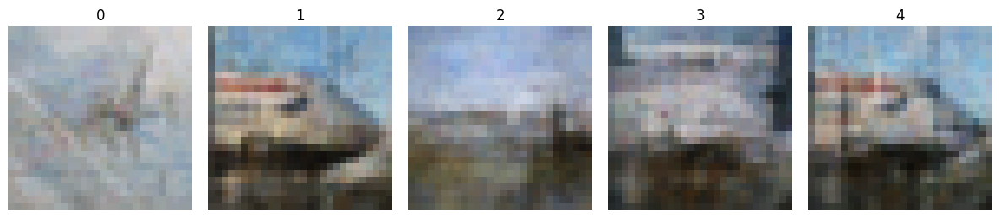

Generating and displaying images for class: bicycle
1/1 [==============================] - 0s 69ms/step


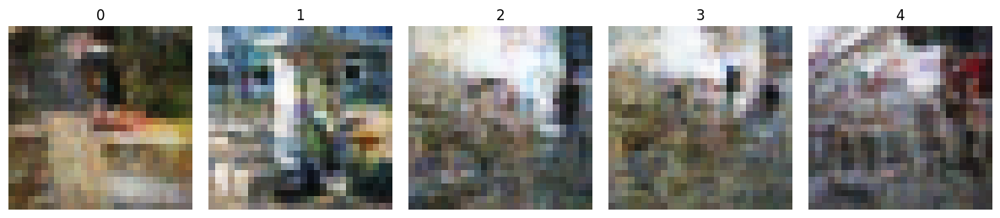

Generating and displaying images for class: bird
1/1 [==============================] - 0s 83ms/step


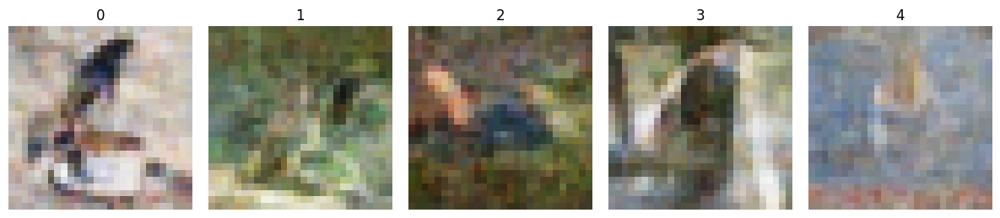

Generating and displaying images for class: boat
1/1 [==============================] - 0s 45ms/step


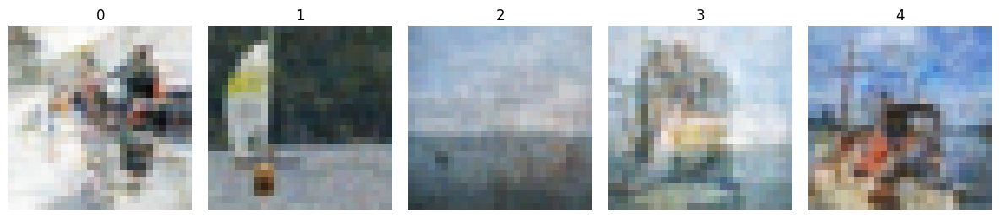

Generating and displaying images for class: bottle
1/1 [==============================] - 0s 84ms/step


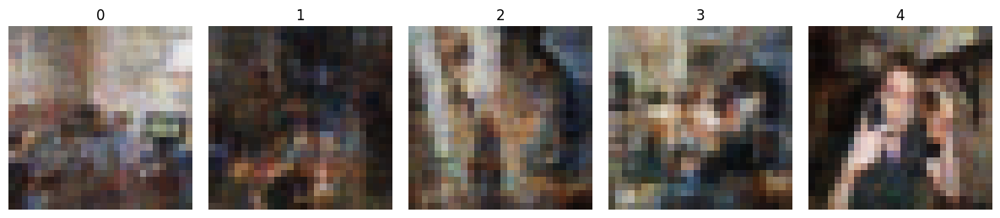

Generating and displaying images for class: bus
1/1 [==============================] - 0s 20ms/step


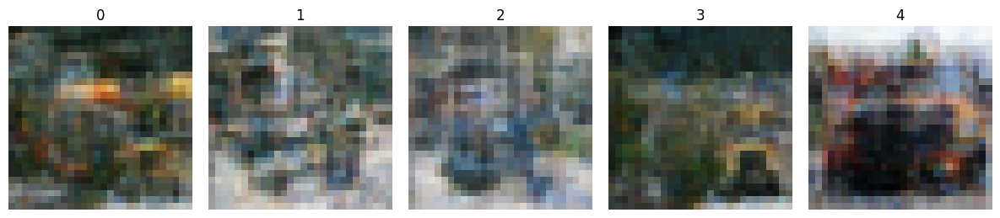

Generating and displaying images for class: car
1/1 [==============================] - 0s 21ms/step


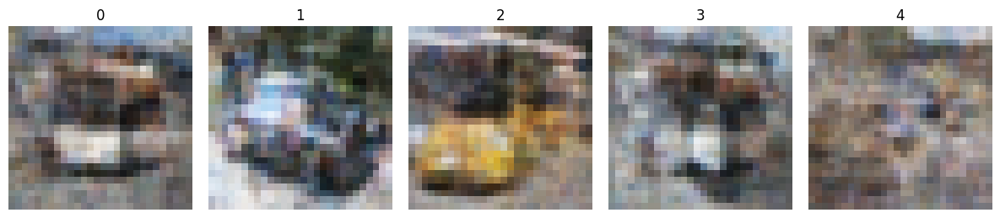

Generating and displaying images for class: cat
1/1 [==============================] - 0s 20ms/step


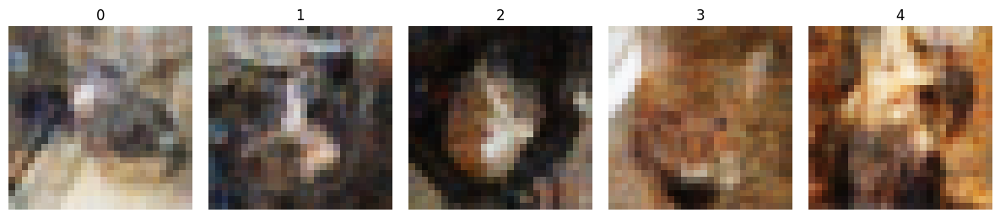

Generating and displaying images for class: chair
1/1 [==============================] - 0s 19ms/step


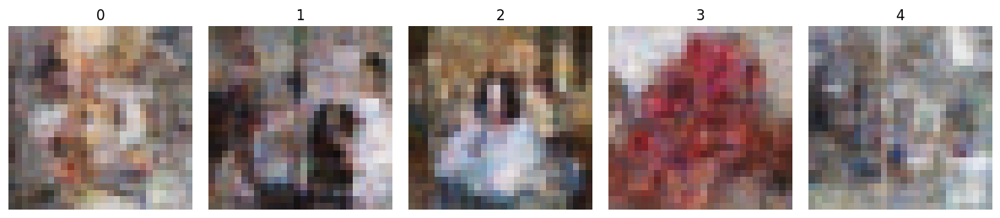

Generating and displaying images for class: cow
1/1 [==============================] - 0s 20ms/step


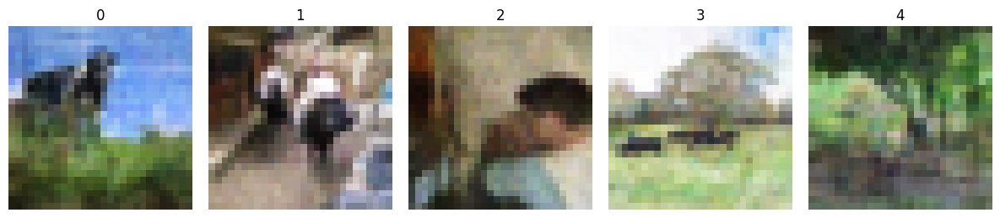

Generating and displaying images for class: diningtable
1/1 [==============================] - 0s 25ms/step


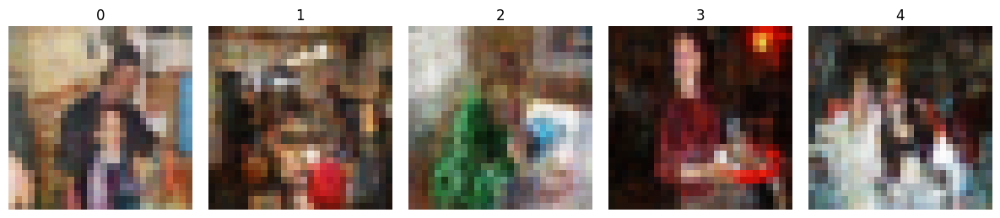

Generating and displaying images for class: dog
1/1 [==============================] - 0s 19ms/step


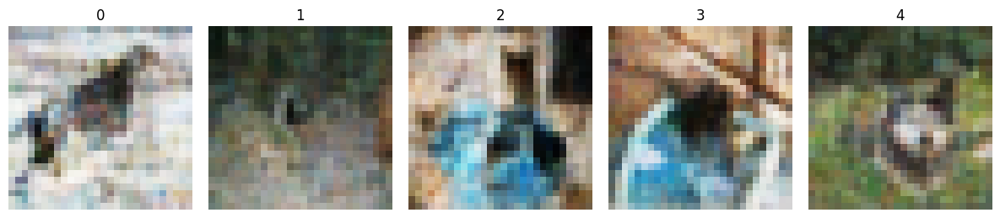

Generating and displaying images for class: horse
1/1 [==============================] - 0s 20ms/step


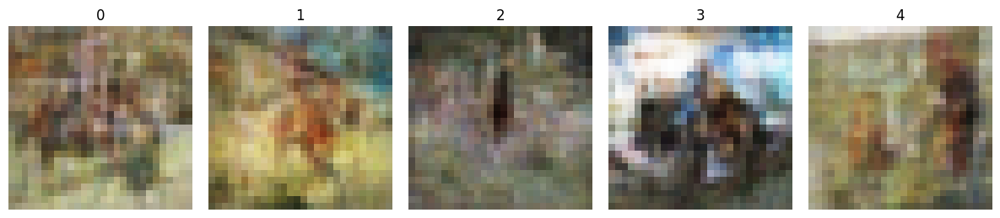

Generating and displaying images for class: motorbike
1/1 [==============================] - 0s 25ms/step


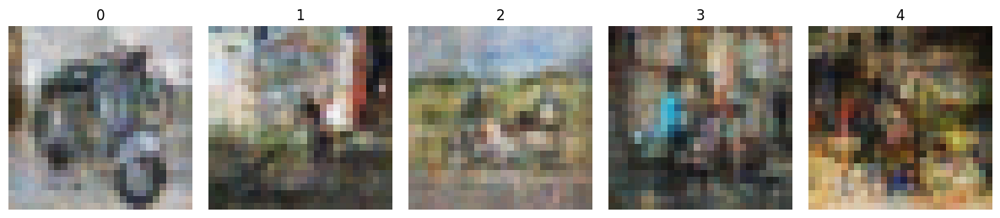

Generating and displaying images for class: person
1/1 [==============================] - 0s 22ms/step


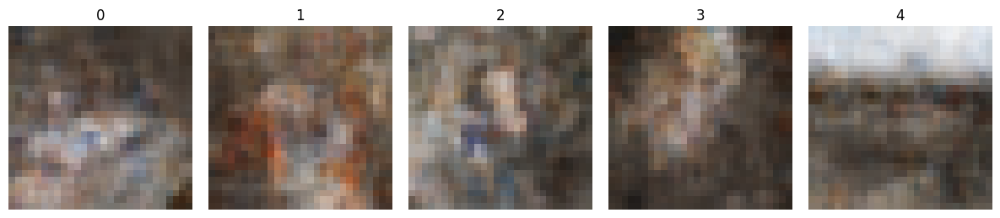

Generating and displaying images for class: pottedplant
1/1 [==============================] - 0s 20ms/step


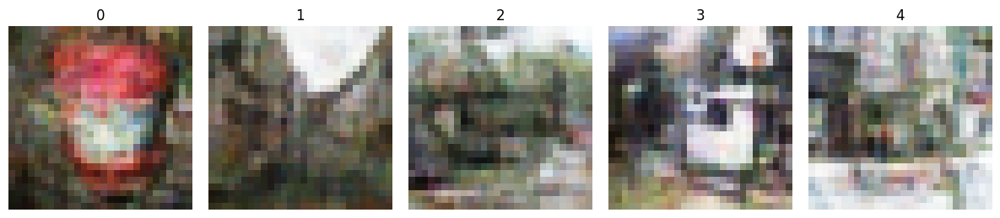

Generating and displaying images for class: sheep
1/1 [==============================] - 0s 21ms/step


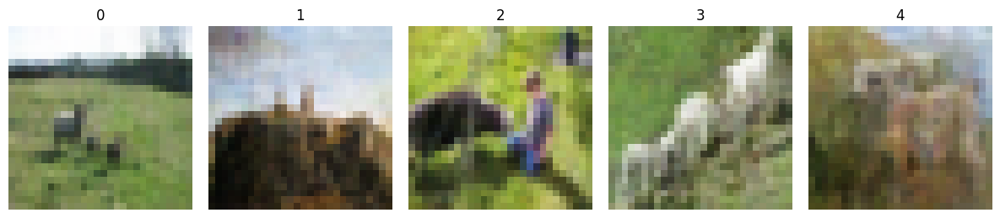

Generating and displaying images for class: sofa
1/1 [==============================] - 0s 22ms/step


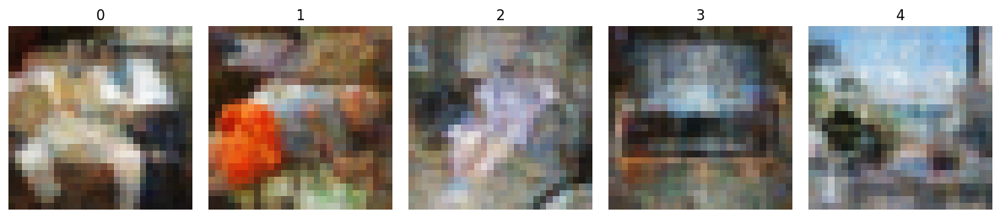

Generating and displaying images for class: tvmonitor
1/1 [==============================] - 0s 19ms/step


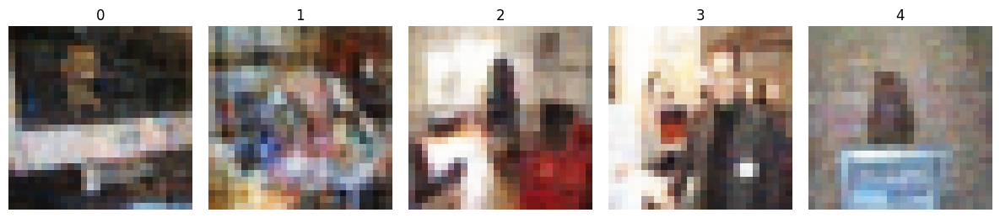

Generating and displaying images for class: train
1/1 [==============================] - 0s 20ms/step


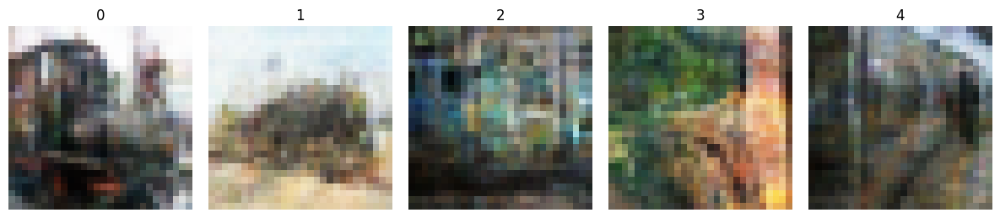

In [ ]:
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model

# Function to generate images from random latent vectors
def generate_images(vae, num_samples=25):
    # Generate random latent vectors
    latent_vectors = np.random.normal(size=(num_samples, latent_dim))
    # Decode the latent vectors to generate images
    print(vae)
    generated_images = vae.predict(latent_vectors)
    return generated_images

# Function to display generated images
def display_generated_images(generated_images):
    num_samples = generated_images.shape[0]
    plt.figure(figsize=(12, 12))
    for i in range(num_samples):
        plt.subplot(5, 5, i+1)
        plt.imshow(generated_images[i])
        plt.title(i)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# Generate and display images using the trained VAE model
num_samples = 25 # Number of images to generate
for class_name, vae_model in loaded_models.items():
    print(f"Generating and displaying images for class: {class_name}")
    generated_images = generate_images(vae_model, num_samples=num_samples)
    display_generated_images(generated_images)

#### Saving 25 Generated Images of Each class On google Drive and saving the path in thhe same dataframe

In [ ]:
import numpy as np
from PIL import Image

# Define the target width and height
target_width = 486
target_height = 500

# Assuming you have a base directory where you want to save the images
gen_base_dir = "/content/VOCdevkit/VOC2008/JPEGImages"

for class_name, vae_model in loaded_models.items():
    print(f"Generating and saving images for class: {class_name}")
    generated_images = generate_images(vae_model, num_samples=num_samples)

    # Save each generated image to the respective class folder
    for i, image in enumerate(generated_images):
        image_filename = os.path.join(gen_base_dir, f"{class_name}_{i}.jpg")

        # Convert the image array to uint8 and then to PIL Image
        image = (image * 255).astype(np.uint8)
        image_pil = Image.fromarray(image)

        # Resize the image
        resized_image = image_pil.resize((target_width, target_height))

        # Save the resized image
        resized_image.save(image_filename)
        new_row = [ f"{class_name}_{i}.jpg", 'train', [class_name]]
        new_row_dict = {'id': new_row[0], 'set': new_row[1], 'target': new_row[2]}
        # Append the new row to the DataFrame
        df = df.append(new_row_dict, ignore_index=True)


    print(f"Images saved for class: {class_name}")

Generating and saving images for class: aeroplane
1/1 [==============================] - 3s 3s/step
Images saved for class: aeroplane
Generating and saving images for class: bicycle
1/1 [==============================] - 0s 105ms/step
Images saved for class: bicycle
Generating and saving images for class: bird
1/1 [==============================] - 0s 114ms/step
Images saved for class: bird
Generating and saving images for class: boat
1/1 [==============================] - 0s 114ms/step
Images saved for class: boat
Generating and saving images for class: bottle


1/1 [==============================] - 0s 110ms/step
Images saved for class: bottle
Generating and saving images for class: bus


1/1 [==============================] - 0s 113ms/step
Images saved for class: bus
Generating and saving images for class: car
1/1 [==============================] - 0s 108ms/step
Images saved for class: car
Generating and saving images for class: cat
1/1 [==============================] - 0s 105ms/step
Images saved for class: cat
Generating and saving images for class: chair
1/1 [==============================] - 0s 110ms/step
Images saved for class: chair
Generating and saving images for class: cow
1/1 [==============================] - 0s 106ms/step
Images saved for class: cow
Generating and saving images for class: diningtable
1/1 [==============================] - 0s 109ms/step
Images saved for class: diningtable
Generating and saving images for class: dog
1/1 [==============================] - 0s 112ms/step
Images saved for class: dog
Generating and saving images for class: horse
1/1 [==============================] - 0s 101ms/step
Images saved for class: horse
Generating and savin

### Defining The Data Generator

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing.image import Iterator


def create_data_generators(df, label, batch_size=32):
    target_size = (224, 224)

    df[label] = df['target'].apply(lambda x: 1 if label in x else 0)



    # Image data generator for original images
    datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )

    train_generator = datagen.flow_from_dataframe(
        dataframe=df[df['set'] == 'train'],  # Corrected placement of 'dataframe'
        directory=IMAGES_DIR,
        x_col='id',
        y_col=label,
        batch_size=batch_size,
        target_size=target_size,
        class_mode='raw',  # Corrected class_mode
        shuffle=True
    )


    validation_generator = datagen.flow_from_dataframe(
        dataframe=df[df['set'] == 'val'],  # Corrected placement of 'dataframe'
        directory=IMAGES_DIR,
        x_col='id',
        y_col=label,
        batch_size=batch_size,
        target_size=target_size,
        class_mode='raw',  # Corrected class_mode
        shuffle=False
    )
    return train_generator, validation_generator

### Defining The Models

In [ ]:
class BinaryModel(tf.keras.Model):
    def __init__(self, label, folder_path=None):
        super().__init__()

        self.label = label
        input_shape = (224, 224, 3)
        print(label)
        if folder_path:
            model_path = os.path.join(folder_path, label + '.keras')
            print(model_path)
            if os.path.isfile(model_path):
                self._model = load_model(model_path)
                print('loaded', model_path)
        else:
            base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
            for layer in base_model.layers:
                layer.trainable = False
            x = base_model.output
            x = layers.GlobalAveragePooling2D()(x)
            x = layers.Dense(128, activation='relu')(x)
            x = layers.Dropout(0.5)(x)
            predictions = layers.Dense(1, activation='sigmoid')(x)

            # Create the model
            self._model = Model(inputs=base_model.input, outputs=predictions)
            self.build(input_shape=(None, *input_shape))

    def call(self, inputs):
        return self._model(inputs)

    def summary(self):
        return self._model.summary()

    def save(self, folder_path):
        self._model.save(os.path.join(folder_path, self.label + '500.keras'))

### Models Training


In [ ]:
def AP(y_true, y_pred):
    return tf.py_function(average_precision_score, [y_true, y_pred], tf.float32)

def train_model_for_label(label, df, already_done_labels, FOLDER_PATH, EPOCHS=50, BATCH_SIZE=25, OPTIMIZER='Adam', LOSS='binary_crossentropy', PATIENCE=5, MIN_DELTA=0.02, TARGET_SIZE=(224, 224, 3)):
    if label+'500' in already_done_labels:
        print("Skipping ", label, "- Model already trained.")
        return

    early_stopping = EarlyStopping(
        monitor='val_AP',
        min_delta=MIN_DELTA,
        patience=PATIENCE,
        verbose=1,
        mode='max',
        restore_best_weights=True,
        start_from_epoch=2
    )

    model = BinaryModel(label)

    model.compile(
        optimizer=OPTIMIZER,
        loss=LOSS,
        metrics=[AP],
    )


    train_gen, val_gen = create_data_generators(df, label,batch_size=32)


    model.fit(
        train_gen,
        epochs=EPOCHS,
        validation_data=val_gen,
        callbacks=[early_stopping]
    )

    model.save(FOLDER_PATH)

### Training Model for each Label

In [ ]:
FOLDER_PATH='/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models'
os.makedirs(FOLDER_PATH, exist_ok=True)
already_done_labels = [item.removesuffix('.keras') for item in os.listdir(FOLDER_PATH)]
for label in labels:
  print(f"Training The Model for label {label}")
  train_model_for_label(label, df, already_done_labels, FOLDER_PATH)
  print("\n\n")

Training The Model for label aeroplane
Skipping  aeroplane - Model already trained.



Training The Model for label bicycle
Skipping  bicycle - Model already trained.



Training The Model for label bird
Skipping  bird - Model already trained.



Training The Model for label boat
Skipping  boat - Model already trained.



Training The Model for label bottle
Skipping  bottle - Model already trained.



Training The Model for label bus
Skipping  bus - Model already trained.



Training The Model for label car
Skipping  car - Model already trained.



Training The Model for label cat
Skipping  cat - Model already trained.



Training The Model for label chair
Skipping  chair - Model already trained.



Training The Model for label cow
Skipping  cow - Model already trained.



Training The Model for label diningtable
Skipping  diningtable - Model already trained.



Training The Model for label dog
Skipping  dog - Model already trained.



Training The Model for label horse
Skipping  horse

### TOP 10 Images of Each Class

Found 2111 validated image filenames.
Found 2221 validated image filenames.
tvmonitor500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/tvmonitor500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/tvmonitor500.keras
70/70 [==============================] - 12s 166ms/step


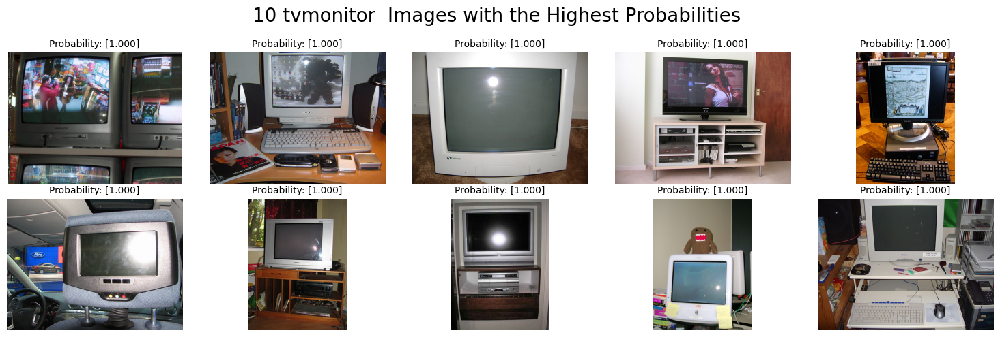

Found 2111 validated image filenames.
Found 2221 validated image filenames.
train500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/train500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/train500.keras
70/70 [==============================] - 9s 129ms/step


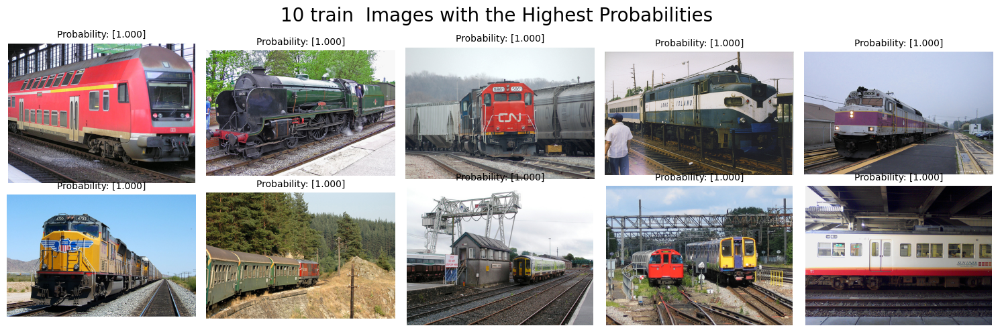

Found 2111 validated image filenames.
Found 2221 validated image filenames.
sofa500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/sofa500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/sofa500.keras
70/70 [==============================] - 10s 134ms/step


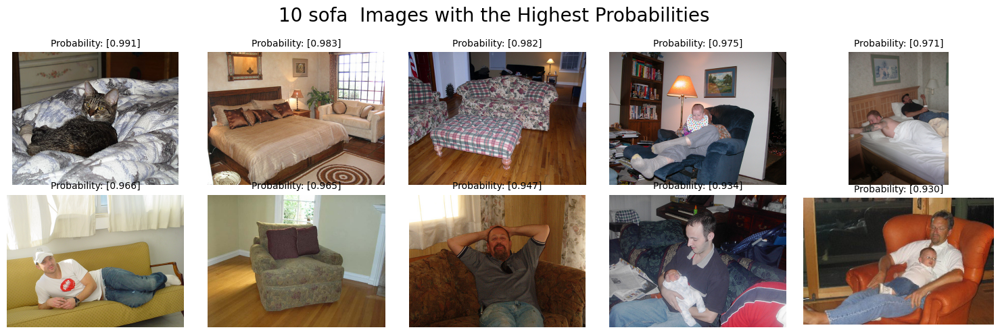

Found 2111 validated image filenames.
Found 2221 validated image filenames.
sheep500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/sheep500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/sheep500.keras
70/70 [==============================] - 11s 151ms/step


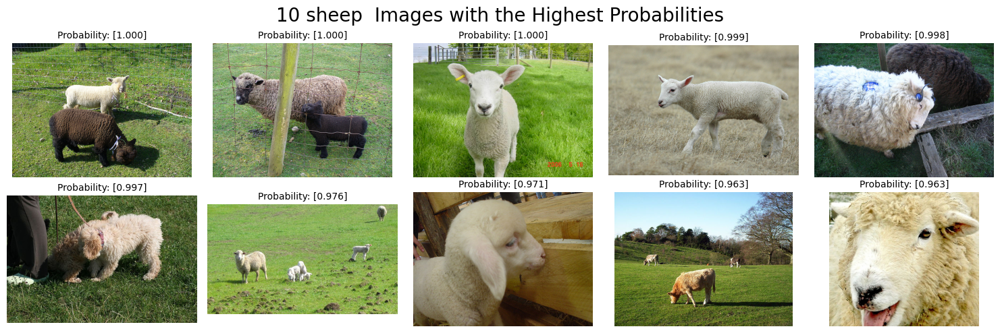

Found 2111 validated image filenames.
Found 2221 validated image filenames.
pottedplant500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/pottedplant500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/pottedplant500.keras
70/70 [==============================] - 11s 162ms/step


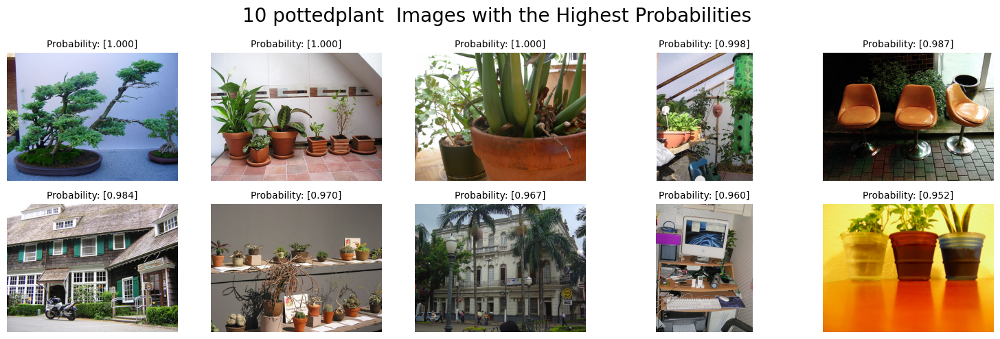

Found 2111 validated image filenames.
Found 2221 validated image filenames.
person500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/person500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/person500.keras
70/70 [==============================] - 11s 161ms/step


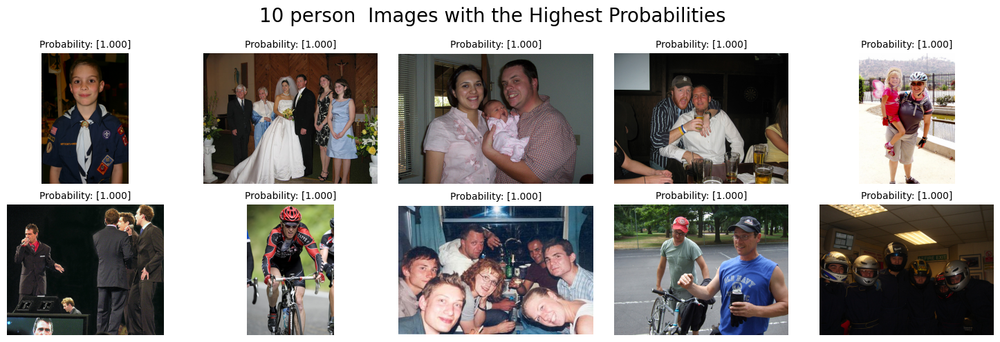

Found 2111 validated image filenames.
Found 2221 validated image filenames.
motorbike500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/motorbike500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/motorbike500.keras
70/70 [==============================] - 13s 180ms/step


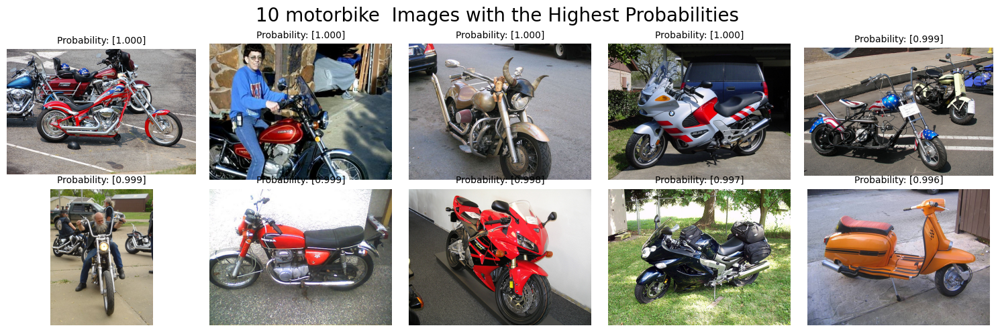

Found 2111 validated image filenames.
Found 2221 validated image filenames.
horse500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/horse500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/horse500.keras
70/70 [==============================] - 14s 192ms/step


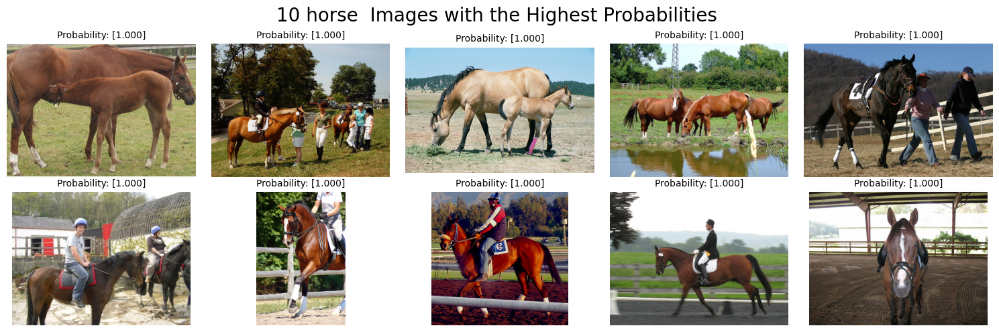

Found 2111 validated image filenames.
Found 2221 validated image filenames.
dog500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/dog500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/dog500.keras
70/70 [==============================] - 13s 183ms/step


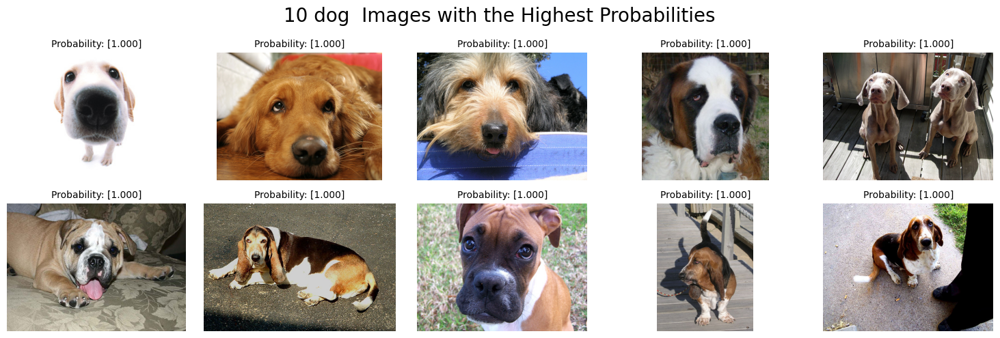

Found 2111 validated image filenames.
Found 2221 validated image filenames.
diningtable500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/diningtable500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/diningtable500.keras
70/70 [==============================] - 13s 188ms/step


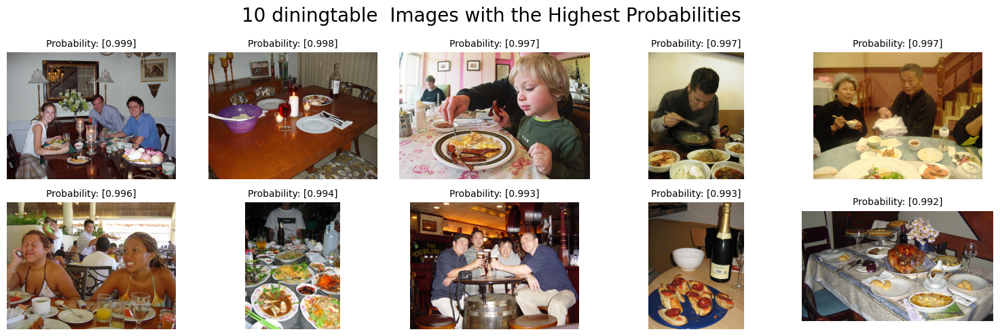

Found 2111 validated image filenames.
Found 2221 validated image filenames.
cow500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/cow500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/cow500.keras
70/70 [==============================] - 14s 193ms/step


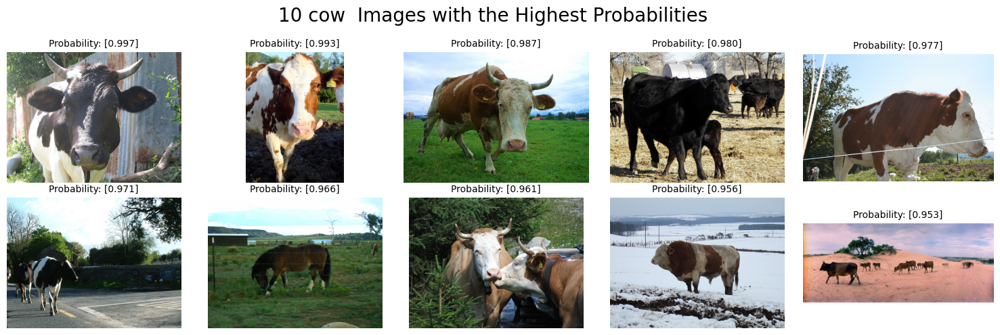

Found 2111 validated image filenames.
Found 2221 validated image filenames.
chair500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/chair500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/chair500.keras
70/70 [==============================] - 14s 200ms/step


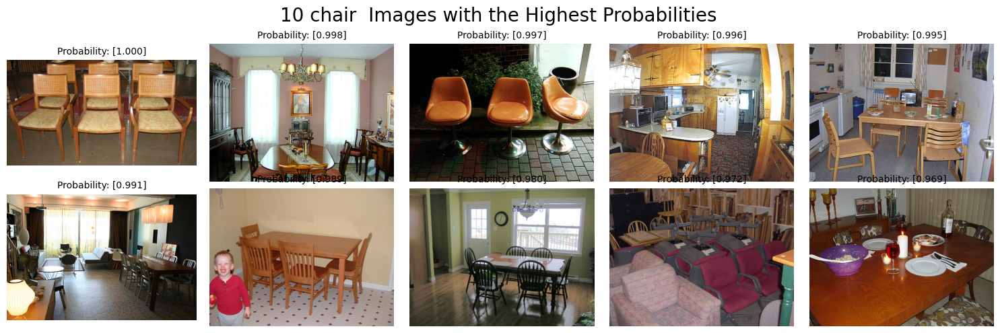

Found 2111 validated image filenames.
Found 2221 validated image filenames.
cat500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/cat500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/cat500.keras
70/70 [==============================] - 14s 196ms/step


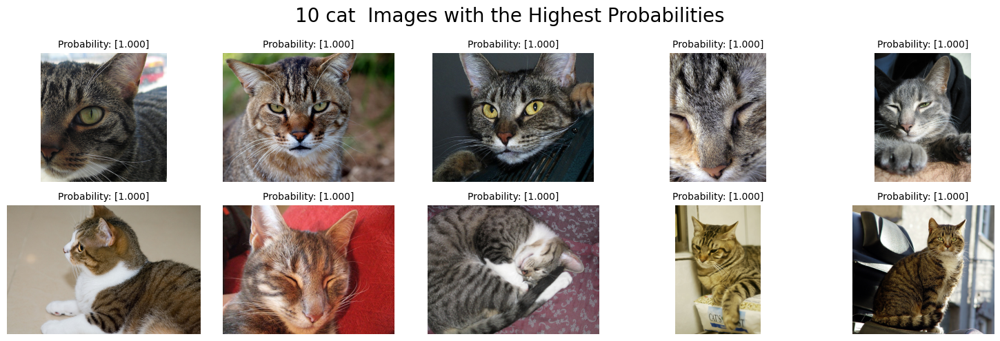

Found 2111 validated image filenames.
Found 2221 validated image filenames.
car500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/car500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/car500.keras
70/70 [==============================] - 14s 193ms/step


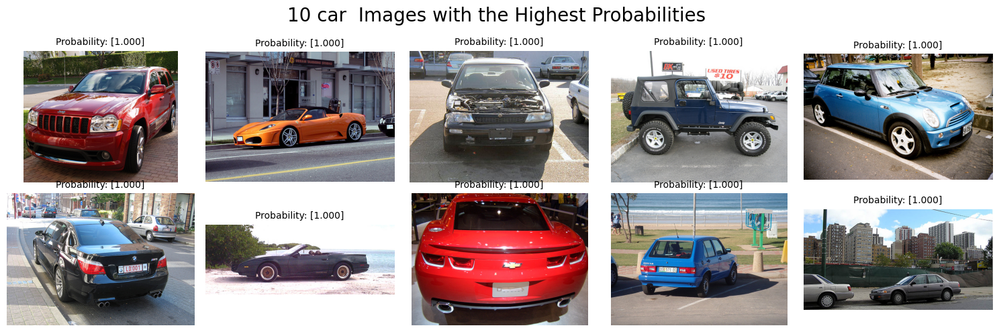

Found 2111 validated image filenames.
Found 2221 validated image filenames.
bus500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/bus500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/bus500.keras
70/70 [==============================] - 14s 205ms/step


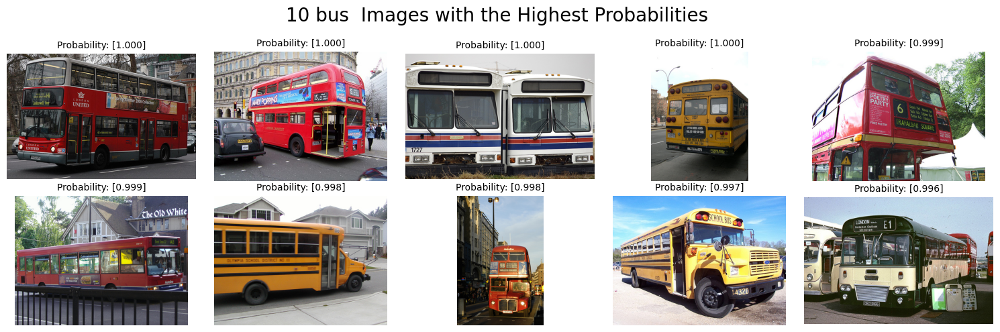

Found 2111 validated image filenames.
Found 2221 validated image filenames.
bottle500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/bottle500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/bottle500.keras
70/70 [==============================] - 14s 194ms/step


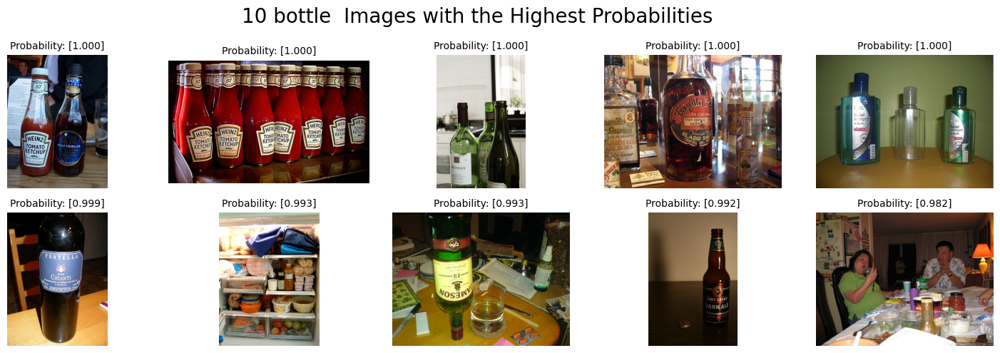

Found 2111 validated image filenames.
Found 2221 validated image filenames.
boat500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/boat500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/boat500.keras
70/70 [==============================] - 13s 186ms/step


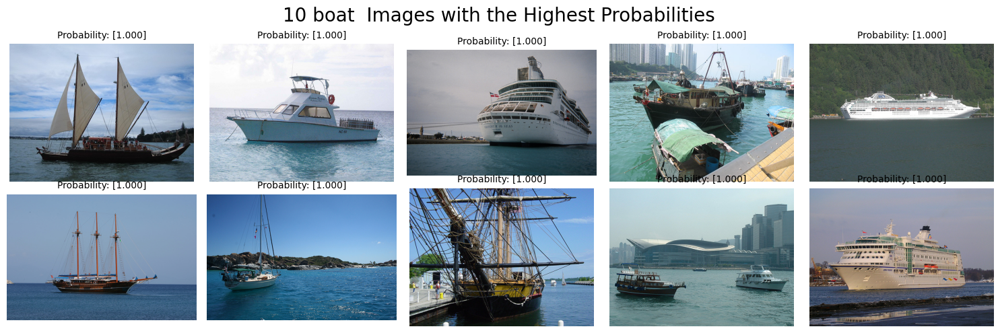

Found 2111 validated image filenames.
Found 2221 validated image filenames.
bird500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/bird500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/bird500.keras
70/70 [==============================] - 13s 186ms/step


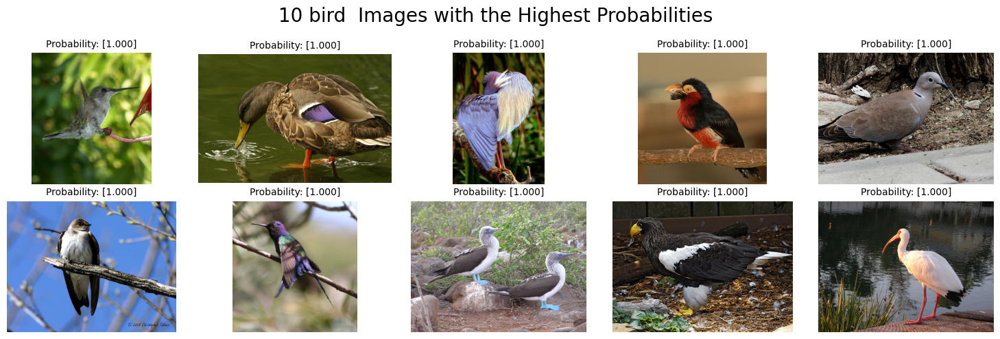

Found 2111 validated image filenames.
Found 2221 validated image filenames.
bicycle500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/bicycle500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/bicycle500.keras
70/70 [==============================] - 14s 192ms/step


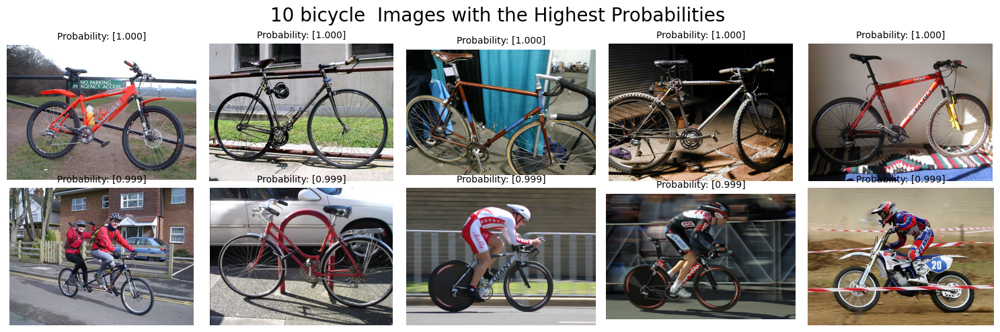

Found 2111 validated image filenames.
Found 2221 validated image filenames.
aeroplane500
/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/aeroplane500.keras
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models/aeroplane500.keras
70/70 [==============================] - 14s 200ms/step


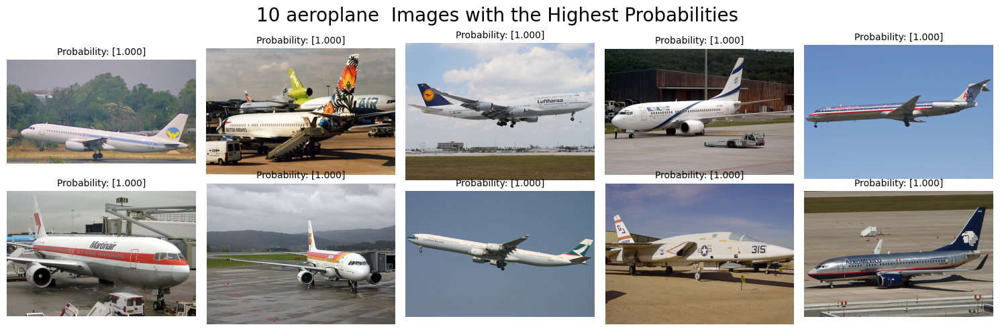

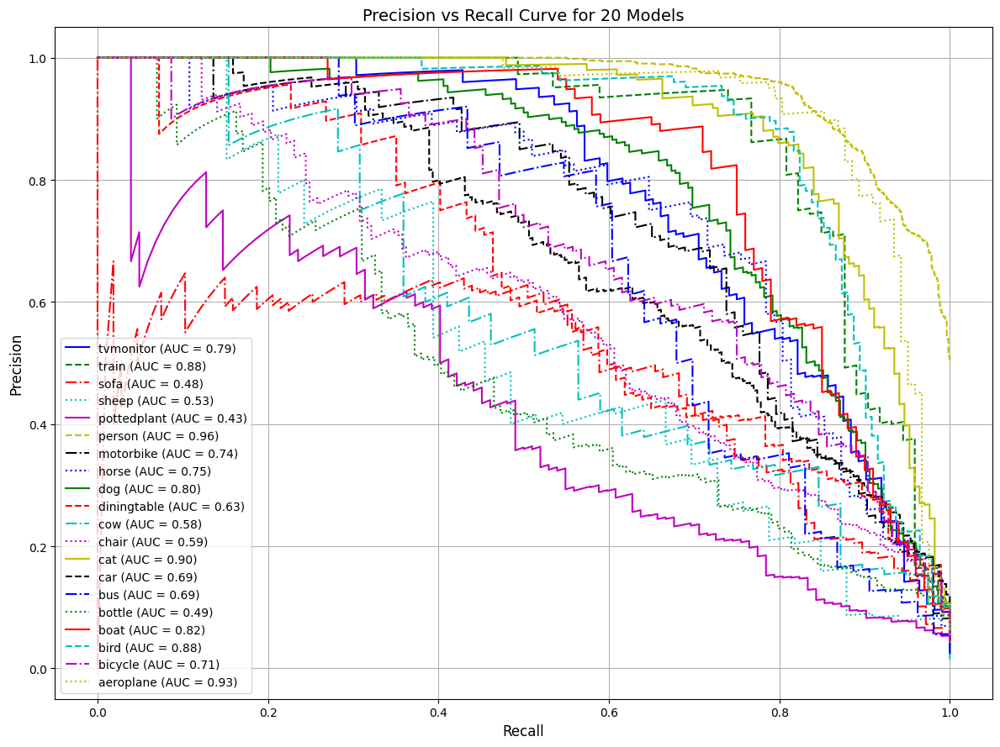

In [ ]:

MODELS_DIR = '/content/drive/MyDrive/GenAI_Project_A/VGG_VAE_Models'

model_type='500'
THRESHOLD = 0.65
metrics = []
for _label in os.listdir(MODELS_DIR):
    if _label.endswith(f'{model_type}.keras'):
      label = _label.removesuffix(f'{model_type}.keras')
      _, val_gen = create_data_generators(df, label)
      model = BinaryModel(f'{label}{model_type}', folder_path=MODELS_DIR)

      y_pred = model.predict(val_gen)

      np.set_printoptions(formatter={'float': lambda x: "{:.3f}".format(x)})


      top_indices = np.argsort(y_pred, axis=0)[-10:][::-1]
      top_indices = [inner_list[0] for inner_list in top_indices]


      filenames = val_gen.filenames


      num_rows = (len(top_indices) + 4) // 5
      fig, axs = plt.subplots(num_rows, 5, figsize=(15, 5))
      fig.suptitle(f"10 {label}  Images with the Highest Probabilities ", fontsize=20)

      for i, idx in enumerate(top_indices):

          image_id = filenames[idx]
          img = Image.open(os.path.join(IMAGES_DIR, image_id))


          predicted_probability = y_pred[idx]

          row = i // 5
          col = i % 5
          axs[row, col].imshow(img)
          axs[row, col].set_title(f'Probability: {predicted_probability}',fontsize=10)
          axs[row, col].axis('off')


      for i in range(len(top_indices), num_rows*5):
          row = i // 5
          col = i % 5
          fig.delaxes(axs[row, col])

      plt.tight_layout()
      plt.show()


      p, r, _ = precision_recall_curve(val_gen.labels, y_pred)
      _auc = auc(r, p)
      metric = {'pr' : (p, r), 'auc' : _auc, 'label' : label }
      metrics.append(metric)

plt.figure(figsize=(12, 9))
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k']
line_styles = ['-', '--', '-.', ':']

for i, metric in enumerate(metrics):
    p, r = metric['pr']
    area_under_curve  = metric['auc']
    label = metric['label']
    color = colors[i % len(colors)]
    line_style = line_styles[i % len(line_styles)]
    plt.plot(r, p, label=f'{label} (AUC = {area_under_curve :.2f})', color=color, linestyle=line_style)

plt.xlabel('Recall', fontsize=12)
plt.ylabel('Precision', fontsize=12)
plt.title('Precision vs Recall Curve for 20 Models', fontsize=14)
plt.legend(loc='lower left', fontsize=10)
plt.grid(True)
plt.tight_layout()
plt.show()

### MAP score

In [ ]:

print("mAP: {:.2f}".format(np.mean([item['auc'] for item in metrics])))

mAP: 0.71
